# Running batch correction (with `harmony`) for the mouse and human atlas datasets

In [1]:
import scanpy as sc
import scanpy.external as sce
import pandas as pd

import random
import gc
import os
import seaborn as sns

In [2]:
WORKDIR="/workdir/dwm269/scMuscle2"
os.chdir(WORKDIR)

In [3]:
gc.enable()

In [4]:
NCORES=16
sc.settings.n_jobs = NCORES

In [5]:
from scripts.py.scantils import *
# from scripts.py.scanplots import *

## Mouse

In [6]:
mouse = sc.read_h5ad("data/atlas/mus_musculus_pp.h5ad")
mouse.shape

(1670120, 393)

In [7]:
sce.pp.harmony_integrate(
    mouse,
    basis="X_pca",
    adjusted_basis="X_pca_harmony",
    key="GSM.accession"
)

2023-07-03 07:23:05,346 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-07-03 07:34:18,077 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-07-03 07:34:45,283 - harmonypy - INFO - Iteration 1 of 10
2023-07-03 09:34:50,726 - harmonypy - INFO - Iteration 2 of 10
2023-07-03 11:38:36,896 - harmonypy - INFO - Converged after 2 iterations


In [8]:
reorder_reduction(
    mouse,
    reduction="X_pca_harmony",
    verbose=True
)

Reduction variance by dimension:
[5.1680646, 6.057317, 0.61100876, 2.1587312, 3.0713046, 3.172281, 2.4747686, 2.5314028, 2.3562334, 2.082603, 1.8927078, 1.587432, 1.3194937, 1.3815142, 0.84997755, 1.2857867, 1.0679764, 1.0510534, 1.0081301, 0.86822385, 0.9900238, 0.7614338, 0.84047323, 0.8585466, 0.9012475, 0.83994585, 0.75726604, 0.6889682, 0.5888189, 0.7363306, 0.77155894, 0.7347685, 0.7123855, 0.637517, 0.6699112, 0.67358446, 0.67543435, 0.71115786, 0.64179754, 0.687281, 0.65244544, 0.65492463, 0.6574713, 0.67330146, 0.6671364, 0.6404099, 0.6531707, 0.62758225, 0.6689464, 0.675784]


In [9]:
sc.pp.neighbors(
    mouse,
    n_neighbors=50,
    n_pcs=npcs(mouse, reduction="X_pca_harmony"),
    use_rep="X_pca_harmony",
    key_added="harmony_knn"
)
gc.collect()

46877

In [10]:
sc.tl.leiden(
    mouse,
    resolution=1.2,
    neighbors_key="harmony_knn", 
    key_added=f"harmony_{1.2}"
)

In [11]:
sc.tl.umap(
    mouse,
    neighbors_key="harmony_knn"
)

/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


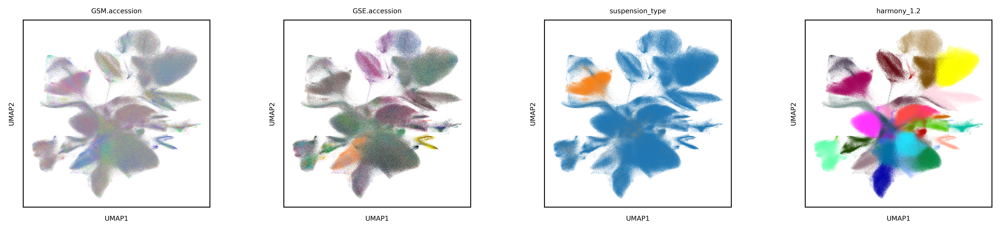

In [12]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=6,
    transparent=False,
    dpi=300
)

sc.pl.umap(
    mouse,
    legend_loc=None, 
    color=["GSM.accession","GSE.accession","suspension_type","harmony_1.2"],
    save="mouse_gsm_umap_harmony.png"
)

In [13]:
mouse.write_h5ad(
    "data/atlas/mus_musculus_pp_harmony.h5ad"
)

In [14]:
# if os.path.exists("data/atlas/mus_musculus_pp_harmony.h5ad"):
#     del mouse

## Human

Load human data...

In [15]:
human = sc.read_h5ad("data/atlas/homo_sapiens_pp.h5ad")
human.shape

(1049414, 488)

In [16]:
sce.pp.harmony_integrate(
    human,
    basis="X_pca",
    adjusted_basis="X_pca_harmony",
    key="GSM.accession"
)

2023-07-03 23:10:50,453 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-07-04 01:26:19,645 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-07-04 01:27:29,272 - harmonypy - INFO - Iteration 1 of 10
2023-07-04 03:20:27,059 - harmonypy - INFO - Iteration 2 of 10
2023-07-04 05:30:46,293 - harmonypy - INFO - Converged after 2 iterations


In [17]:
reorder_reduction(
    human,
    reduction="X_pca_harmony",
    verbose=True
)

Reduction variance by dimension:
[4.4959745, 3.0117357, 3.7238429, 1.4223107, 1.8743544, 1.6632965, 1.6124738, 1.7989722, 1.1186024, 0.97236294, 1.1033891, 0.93297976, 0.6918932, 0.8257884, 0.83812505, 0.9812191, 0.6229691, 0.67958206, 0.6718274, 0.61916625, 0.6832128, 0.6338831, 0.7347645, 0.68649006, 0.7534922, 0.7367983, 0.68954515, 0.64996195, 0.6732773, 0.5712834, 0.6339811, 0.4984341, 0.64878684, 0.6830537, 0.636447, 0.6221321, 0.69330025, 0.6288925, 0.65832853, 0.62626725, 0.64294004, 0.64577854, 0.627705, 0.6449318, 0.62527597, 0.64838254, 0.63827693, 0.6329671, 0.67579395, 0.64126134]


In [18]:
sc.pp.neighbors(
    human,
    n_neighbors=50,
    n_pcs=npcs(human, reduction="X_pca_harmony"),
    use_rep="X_pca_harmony",
    key_added="harmony_knn"
)
gc.collect()

36508

In [19]:
sc.tl.leiden(
    human,
    resolution=1.2,
    neighbors_key="harmony_knn", 
    key_added=f"harmony_{1.2}"
)
gc.collect()

0

In [20]:
sc.tl.umap(
    human,
    neighbors_key="harmony_knn"
)
gc.collect()

30070

In [21]:
palette=sns.color_palette(
    "hls", 
    len(human.obs["GSM.accession"].unique())
)
random.shuffle(palette)
human.uns['GSM.accession_colors'] =  ["#{:02x}{:02x}{:02x}".format(int(r * 255), int(g * 255), int(b * 255)) for r, g, b in palette]

/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


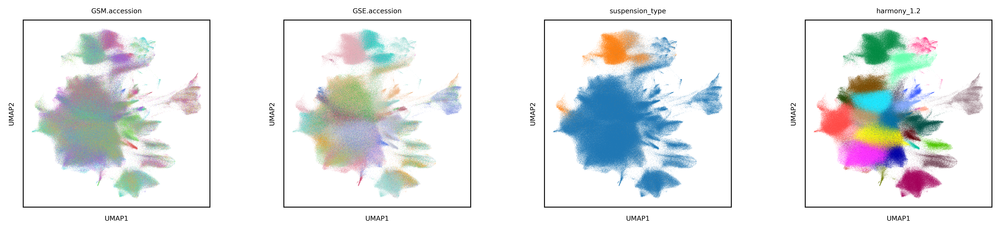

In [22]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=6,
    transparent=False,
    dpi=300
)

sc.pl.umap(
    human,
    legend_loc=None, 
    color=["GSM.accession","GSE.accession","suspension_type","harmony_1.2"],
    save="human_gsm_umap_harmony.png"
)

In [23]:
human.write_h5ad(
    "data/atlas/homo_sapiens_pp_harmony.h5ad"
)

In [24]:
# if os.path.exists("data/atlas/homo_sapiens_pp_harmony.h5ad"):
#     del human